<a href="https://colab.research.google.com/github/mkurach/ComputerSimulationMethods/blob/main/schrod.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib import animation
import math
import random
import scipy.sparse.linalg


In [14]:
xmin = -5
xmax = 25
J=1000
delta_x = (xmax-xmin)/J

t0 = 0
t = 4
delta_t = 0.002
Nt = int((t-t0)/delta_t)

k0 = 10
delta_k = 0.75

V0 = 105
sigma = 0.5
mu = 10

In [15]:
x = np.linspace(xmin,xmax,J)

In [16]:
#potencjal
V = np.zeros(J)
for i in range (J):
    V[i] = V0*np.exp(-pow(x[i]-mu,2)/pow(sigma,2))   

In [17]:
#macierze
A = np.diag([-1j * delta_t/2/pow(delta_x,2) for i in range(J-1)], -1) +\
      np.diag([(1 + 1j * delta_t/2 * (2/pow(delta_x,2)+V[i])) for i in range(J)]) +\
      np.diag([-1j * delta_t/2/pow(delta_x,2) for i in range(J-1)], 1)

R = np.diag([1j * delta_t/2/pow(delta_x,2) for i in range(J-1)], -1) +\
      np.diag([(1 - 1j * delta_t/2 * (2/pow(delta_x,2)+V[i])) for i in range(J)]) +\
      np.diag([1j * delta_t/2/pow(delta_x,2) for i in range(J-1)], 1)

In [18]:
#wartosci poczatkowe funkcji
psi0 = np.zeros(J, dtype='complex_')

for i in range(1, J-1):
        psi0[i] = np.sqrt(delta_k)/pow(np.pi,1/4)*np.exp(-pow(x[i],2)*pow(delta_k,2)/2)*np.exp(-1j*k0*x[i])   

In [20]:
#pierwszy krok
psi = np.linalg.solve(R,A.dot(psi0))

Psi = []
Psi.append(np.abs(psi))

psi_real = []
psi_real.append(np.real(psi))

psi_im = []
psi_im.append(np.imag(psi))

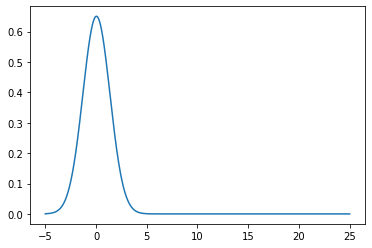

In [21]:
plt.plot(x,np.abs(psi))

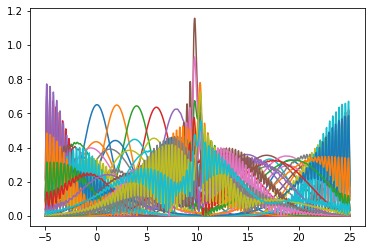

In [22]:
for i in range(Nt-1):
    psi = np.linalg.solve(R,A.dot(psi)) #wykonanie kolejnego kroku na podstawie poprzednieogo
    Psi.append(np.abs(psi))
    psi_real.append(np.real(psi))
    psi_im.append(np.imag(psi))
    if i%50==0: 
        plt.plot(x, np.abs(psi))

plt.show()

In [23]:
print(len(x),len(np.abs(psi)))

1000 1000


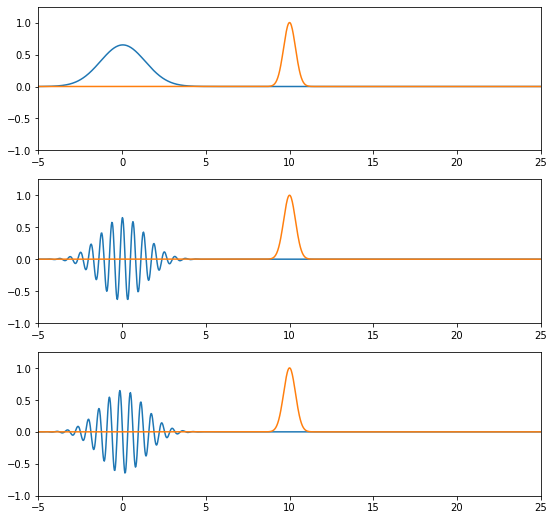

In [26]:
#%matplotlib inline
from IPython.display import HTML
fig, ax = plt.subplots(nrows=3,figsize=(9,9))

ymin = -1
ymax = 1.25



def animate(frame):
  psi_tmp = psi[frame]
  ax[0].clear()
  ax[1].clear()
  ax[2].clear()
  ax[0].set_xlim([xmin,xmax])
  ax[1].set_xlim([xmin,xmax])
  ax[2].set_xlim([xmin,xmax])
  ax[0].set_ylim([ymin,ymax])
  ax[1].set_ylim([ymin,ymax])
  ax[2].set_ylim([ymin,ymax])

  ax[0].plot(x,Psi[frame],label="abs")
  ax[0].plot(x,V/V0)
  ax[1].plot(x,psi_real[frame],label="real")
  ax[1].plot(x,V/V0)
  ax[2].plot(x,psi_im[frame],label="im")
  ax[2].plot(x,V/V0)

ani = FuncAnimation(fig, animate, frames = 900,interval = 10)
HTML(ani.to_html5_video())
ani